In [1]:
import os
import sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

import ipywidgets as widgets
from IPython.display import display

%matplotlib inline

In [29]:
df.to_feather('./data/train.feather')

In [2]:
# train_df = pd.read_csv('/Users/nikhil20.sharma/Library/CloudStorage/GoogleDrive-nikhil.sharma1294@gmail.com/.shortcut-targets-by-id/1hJdN4IVIzv_akIWArIYt52MlRCEbxXvV/its.nikhilksharma/REPOs/RIL-Jio/JFS/scoreCardModeling/dump/JFSCreditScoreModel/Data/Training_Data.csv')
# val_df = pd.read_csv('/Users/nikhil20.sharma/Library/CloudStorage/GoogleDrive-nikhil.sharma1294@gmail.com/.shortcut-targets-by-id/1hJdN4IVIzv_akIWArIYt52MlRCEbxXvV/its.nikhilksharma/REPOs/RIL-Jio/JFS/scoreCardModeling/dump/JFSCreditScoreModel/Data/Validation_Data.csv')
# df = pd.concat([train_df, val_df])
# df.to_csv('./data/data.csv', index=False)

In [3]:
df = pd.read_csv('./data/data.csv')

# Data Exploration

In [4]:
df.tail()

,count_add_on_rchrgs_last_3mnths,latest_channel_used,most_usd_chnl_lst_5_rchrgs,count_pymnt_dly_last_3mnts,max_pymnt_dly_last_3mths,base_plan_value_lst,no_outstation_visit_month_1,distinct_ncell_id_month_1,switched_off_days_6_month,Finance,...,Health,Travel,device_price_segment,count_offline_rchrgs_last_9mnths,total_device_used_2_year,rvnue_prcnt_chnge_cumulative_lst_3_months,rvnue_prcnt_chnge_cumulative_lst_6_months,rvnue_prcnt_chnge_cumulative_lst_9_months,age,Flag
894983,1.0,MYJIO,PhonePE,0.0,0.0,666.0,3.0,10.0,0.0,2.0,...,NaN,7.0,10 TO 15K,0.0,2.0,23.0,18.5,23.0,35.0,0
894984,38.0,EURONET,EURONET,0.0,0.0,719.0,3.0,11.0,0.0,195.0,...,9.0,3.0,15 TO 20K,0.0,4.0,102.7,75.0,135.5,24.0,0
894985,0.0,PhonePE,PhonePE,3.0,9.0,299.0,NaN,NaN,1.0,44.0,...,1.0,NaN,20 TO 30K,0.0,4.0,-8.9,16.8,4.9,29.0,0
894986,0.0,MYJIO,JioAssociate,1.0,10.0,199.0,NaN,NaN,1.0,33.0,...,20.0,6.0,10 TO 15K,1.0,2.0,-100.0,-100.0,-100.0,21.0,0
894987,0.0,BILLDESK,MYJIO,1.0,40.0,209.0,1.0,13.0,5.0,9.0,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0


In [5]:
df.shape

(894988, 22)

In [6]:
print(list(df.columns))

['count_add_on_rchrgs_last_3mnths', 'latest_channel_used', 'most_usd_chnl_lst_5_rchrgs', 'count_pymnt_dly_last_3mnts', 'max_pymnt_dly_last_3mths', 'base_plan_value_lst', 'no_outstation_visit_month_1', 'distinct_ncell_id_month_1', 'switched_off_days_6_month', 'Finance', 'Online Gaming', 'Credit Card', 'Health', 'Travel', 'device_price_segment', 'count_offline_rchrgs_last_9mnths', 'total_device_used_2_year', 'rvnue_prcnt_chnge_cumulative_lst_3_months', 'rvnue_prcnt_chnge_cumulative_lst_6_months', 'rvnue_prcnt_chnge_cumulative_lst_9_months', 'age', 'Flag']


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 894988 entries, 0 to 894987
Data columns (total 22 columns):
 #   Column                                     Non-Null Count   Dtype  
---  ------                                     --------------   -----  
 0   count_add_on_rchrgs_last_3mnths            894658 non-null  float64
 1   latest_channel_used                        894658 non-null  object 
 2   most_usd_chnl_lst_5_rchrgs                 894658 non-null  object 
 3   count_pymnt_dly_last_3mnts                 894988 non-null  float64
 4   max_pymnt_dly_last_3mths                   894902 non-null  float64
 5   base_plan_value_lst                        894182 non-null  float64
 6   no_outstation_visit_month_1                802857 non-null  float64
 7   distinct_ncell_id_month_1                  802857 non-null  float64
 8   switched_off_days_6_month                  894903 non-null  float64
 9   Finance                                    864819 non-null  float64
 10  Online G

In [8]:
df.Flag.value_counts()

0    844450
1     50538
Name: Flag, dtype: int64

In [9]:
print(f'Target variable is {round(50538*100/844450, 2)}% of the total population')

Target variable is 5.98% of the total population


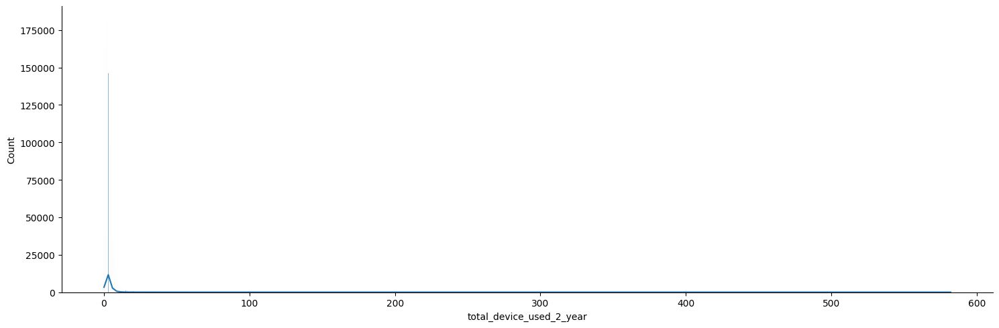

In [10]:
# plt.figure(figsize=(20, 5))
sns.displot(data=df.total_device_used_2_year, kde=True, height=5, aspect=3)
# plt.show()

In [15]:
# Select the DataFrame with numeric features
numeric_df = df.select_dtypes(include=['int64', 'float64'])
categorical_df = df.select_dtypes(exclude=['int64','float64'])

In [16]:
categorical_df

,latest_channel_used,most_usd_chnl_lst_5_rchrgs,device_price_segment
0,GPay,PhonePE,30 TO 50K
1,MYJIO,PhonePE,15 TO 20K
2,GPay,GPay,NaN
3,PayTM,PayTM,20 TO 30K
4,MYJIO,AmaZon,10 TO 15K
...,...,...,...
894983,MYJIO,PhonePE,10 TO 15K
894984,EURONET,EURONET,15 TO 20K
894985,PhonePE,PhonePE,20 TO 30K
894986,MYJIO,JioAssociate,10 TO 15K


# Null Treatment (Numerical)

In [18]:
numeric_df.head()

,count_add_on_rchrgs_last_3mnths,count_pymnt_dly_last_3mnts,max_pymnt_dly_last_3mths,base_plan_value_lst,no_outstation_visit_month_1,distinct_ncell_id_month_1,switched_off_days_6_month,Finance,Online Gaming,Credit Card,Health,Travel,count_offline_rchrgs_last_9mnths,total_device_used_2_year,rvnue_prcnt_chnge_cumulative_lst_3_months,rvnue_prcnt_chnge_cumulative_lst_6_months,rvnue_prcnt_chnge_cumulative_lst_9_months,age,Flag
0,0.0,0.0,0.0,599.0,4.0,9.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,7.9,-7.0,27.0,0
1,0.0,0.0,0.0,555.0,1.0,13.0,0.0,0.0,4.0,0.0,15.0,0.0,0.0,1.0,7.3,0.0,0.0,23.0,0
2,0.0,2.0,6.0,149.0,3.0,12.0,45.0,138.0,20.0,1.0,0.0,1.0,1.0,NaN,0.0,26.1,-15.7,41.0,0
3,0.0,3.0,4.0,239.0,5.0,18.0,10.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,327.8,11.8,1017.9,37.0,0
4,0.0,0.0,0.0,599.0,4.0,19.0,1.0,51.0,0.0,2.0,0.0,5.0,0.0,0.0,0.0,0.0,3.4,46.0,0


In [19]:
null_analysis = numeric_df.isnull().sum().to_frame()
null_analysis.columns = ['nullCount']

In [20]:
df.shape[0]

894988

In [21]:
null_analysis['nullPer'] = null_analysis['nullCount']*100/df.shape[0]

In [22]:
null_analysis

,nullCount,nullPer
count_add_on_rchrgs_last_3mnths,330,0.036872
count_pymnt_dly_last_3mnts,0,0.000000
max_pymnt_dly_last_3mths,86,0.009609
base_plan_value_lst,806,0.090057
no_outstation_visit_month_1,92131,10.294105
distinct_ncell_id_month_1,92131,10.294105
switched_off_days_6_month,85,0.009497
Finance,30169,3.370883
Online Gaming,93665,10.465503
Credit Card,178986,19.998704


In [27]:
print([x for x in dir(px.box) if '__' not in x])

[]


In [24]:
px.box(numeric_df.total_device_used_2_year,)

<AxesSubplot: >

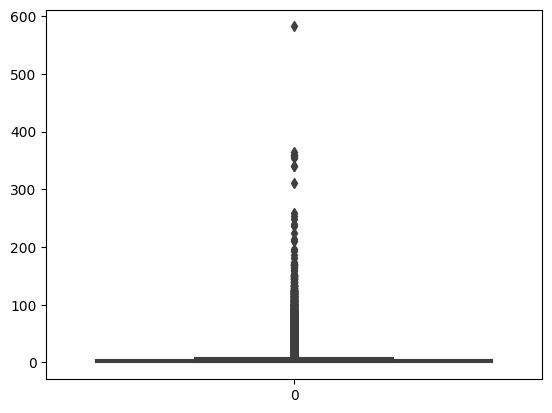

In [25]:
sns.boxplot(numeric_df.total_device_used_2_year)